* LLM used: Meta Llama3 8b Instruct LLM model
* Embedding used: HuggingFace BGE Large EN Embedding model
* Dataset used: TheProcessorFood (HuggingFace)

In [1]:
%%writefile requirements.txt
langchain==0.1.14
pypdf==4.1.0
faiss-cpu==1.8.0
boto3==1.34.58
sqlalchemy==2.0.29

Overwriting requirements.txt


In [2]:
import sqlalchemy
print(sqlalchemy.__version__)

2.0.30


In [3]:
pip install nvidia-ml-py3==7.352.0

  Using cached nvidia_ml_py3-7.352.0-py3-none-any.whl
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
autogluon-multimodal 1.1.1 requires omegaconf<2.3.0,>=2.1.1, but you have omegaconf 2.3.0 which is incompatible.
autogluon-multimodal 1.1.1 requires scikit-learn<1.4.1,>=1.3.0, but you have scikit-learn 1.4.2 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install sqlparse==0.5.0

  Using cached sqlparse-0.5.0-py3-none-any.whl.metadata (3.9 kB)
Using cached sqlparse-0.5.0-py3-none-any.whl (43 kB)
  Attempting uninstall: sqlparse
    Found existing installation: sqlparse 0.5.1
    Uninstalling sqlparse-0.5.1:
      Successfully uninstalled sqlparse-0.5.1
Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install scikit-learn==1.3.0

  Using cached scikit_learn-1.3.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (11 kB)
Using cached scikit_learn-1.3.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (10.9 MB)
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.4.2
    Uninstalling scikit-learn-1.4.2:
      Successfully uninstalled scikit-learn-1.4.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
autogluon-multimodal 1.1.1 requires omegaconf<2.3.0,>=2.1.1, but you have omegaconf 2.3.0 which is incompatible.
autogluon-timeseries 1.1.1 requires gluonts==0.15.1, but you have gluonts 0.14.3 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


In [6]:
pip install omegaconf==2.2.3

  Using cached omegaconf-2.2.3-py3-none-any.whl.metadata (3.9 kB)
Using cached omegaconf-2.2.3-py3-none-any.whl (79 kB)
  Attempting uninstall: omegaconf
    Found existing installation: omegaconf 2.3.0
    Uninstalling omegaconf-2.3.0:
      Successfully uninstalled omegaconf-2.3.0
Note: you may need to restart the kernel to use updated packages.


In [7]:
pip install gluonts==0.15.1

  Using cached gluonts-0.15.1-py3-none-any.whl.metadata (9.9 kB)
Using cached gluonts-0.15.1-py3-none-any.whl (1.5 MB)
  Attempting uninstall: gluonts
    Found existing installation: gluonts 0.14.3
    Uninstalling gluonts-0.14.3:
      Successfully uninstalled gluonts-0.14.3
Note: you may need to restart the kernel to use updated packages.


In [8]:
pip install langchain==0.1.14

  Using cached langchain-0.1.14-py3-none-any.whl.metadata (13 kB)
  Using cached langchain_community-0.0.38-py3-none-any.whl.metadata (8.7 kB)
  Using cached langchain_core-0.1.53-py3-none-any.whl.metadata (5.9 kB)
  Using cached langchain_text_splitters-0.0.2-py3-none-any.whl.metadata (2.2 kB)
  Using cached packaging-23.2-py3-none-any.whl.metadata (3.2 kB)
Using cached langchain-0.1.14-py3-none-any.whl (812 kB)
Using cached langchain_community-0.0.38-py3-none-any.whl (2.0 MB)
Using cached langchain_core-0.1.53-py3-none-any.whl (303 kB)
Using cached langchain_text_splitters-0.0.2-py3-none-any.whl (23 kB)
Using cached packaging-23.2-py3-none-any.whl (53 kB)
  Attempting uninstall: packaging
    Found existing installation: packaging 24.1
    Uninstalling packaging-24.1:
      Successfully uninstalled packaging-24.1
  Attempting uninstall: langchain-core
    Found existing installation: langchain-core 0.2.33
    Uninstalling langchain-core-0.2.33:
      Successfully uninstalled langchai

In [9]:
pip install --upgrade langchain langchain-core

  Using cached langchain-0.3.7-py3-none-any.whl.metadata (7.1 kB)
  Using cached langchain_core-0.3.15-py3-none-any.whl.metadata (6.3 kB)
  Using cached langchain_text_splitters-0.3.2-py3-none-any.whl.metadata (2.3 kB)
  Using cached pydantic-2.9.2-py3-none-any.whl.metadata (149 kB)
  Using cached langsmith-0.1.140-py3-none-any.whl.metadata (13 kB)
  Using cached requests_toolbelt-1.0.0-py2.py3-none-any.whl.metadata (14 kB)
  Using cached pydantic_core-2.23.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (6.6 kB)
Using cached langchain-0.3.7-py3-none-any.whl (1.0 MB)
Using cached langchain_core-0.3.15-py3-none-any.whl (408 kB)
Using cached langchain_text_splitters-0.3.2-py3-none-any.whl (25 kB)
Using cached langsmith-0.1.140-py3-none-any.whl (304 kB)
Using cached pydantic-2.9.2-py3-none-any.whl (434 kB)
Using cached pydantic_core-2.23.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (2.1 MB)
Using cached requests_toolbelt-1.0.0-py2.py3-none-any.whl (54

In [10]:
pip install boto3==1.34.58

  Using cached boto3-1.34.58-py3-none-any.whl.metadata (6.6 kB)
Using cached boto3-1.34.58-py3-none-any.whl (139 kB)
  Attempting uninstall: boto3
    Found existing installation: boto3 1.34.131
    Uninstalling boto3-1.34.131:
      Successfully uninstalled boto3-1.34.131
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
langchain-aws 0.1.16 requires boto3<1.35.0,>=1.34.131, but you have boto3 1.34.58 which is incompatible.
langchain-aws 0.1.16 requires langchain-core<0.3,>=0.2.29, but you have langchain-core 0.3.15 which is incompatible.
sagemaker 2.227.0 requires boto3<2.0,>=1.34.142, but you have boto3 1.34.58 which is incompatible.
Note: you may need to restart the kernel to use updated packages.


In [11]:
!pip install -U -r requirements.txt

  Using cached langchain-0.1.14-py3-none-any.whl.metadata (13 kB)
  Using cached pypdf-4.1.0-py3-none-any.whl.metadata (7.4 kB)
  Using cached faiss_cpu-1.8.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.6 kB)
  Using cached SQLAlchemy-2.0.29-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (9.6 kB)
  Using cached langchain_core-0.1.53-py3-none-any.whl.metadata (5.9 kB)
  Using cached langchain_text_splitters-0.0.2-py3-none-any.whl.metadata (2.2 kB)
  Using cached pydantic_core-2.18.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (6.5 kB)
Using cached langchain-0.1.14-py3-none-any.whl (812 kB)
Using cached pypdf-4.1.0-py3-none-any.whl (286 kB)
Using cached faiss_cpu-1.8.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (27.0 MB)
Using cached SQLAlchemy-2.0.29-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.2 MB)
Using cached langchain_core-0.1.53-py3-none-any.whl (303 kB)
Using cached langchain_

In [12]:
import langchain
print(langchain.__version__)

0.1.14


In [13]:
try:
    import sagemaker
except ImportError:
    !pip install sagemaker

sagemaker.config INFO - Not applying SDK defaults from location: /etc/xdg/sagemaker/config.yaml
sagemaker.config INFO - Not applying SDK defaults from location: /home/sagemaker-user/.config/sagemaker/config.yaml


In [14]:
# Import the JumpStartModel class from the SageMaker JumpStart library
from sagemaker.jumpstart.model import JumpStartModel

In [15]:
# Specify the model ID for the HuggingFace Llama 3 8b Instruct LLM model
model_id = "meta-textgeneration-llama-3-8b-instruct"
accept_eula = True
model = JumpStartModel(model_id=model_id, model_version="2.7.0", instance_type= "ml.g5.2xlarge")

In [16]:
predictor = model.deploy(accept_eula=accept_eula, instance_type="ml.g5.2xlarge")

-----------------!

In [17]:
# Specify the model ID for the HuggingFace BGE Large EN Embedding model
model_id = "huggingface-sentencesimilarity-bge-large-en-v1-5"
text_embedding_model = JumpStartModel(model_id=model_id,model_version="1.1.1")

In [18]:
embedding_predictor = text_embedding_model.deploy(instance_type="ml.g5.2xlarge")

-----------!

In [19]:
import json
import sagemaker

from langchain_core.prompts import PromptTemplate
from langchain_community.llms import SagemakerEndpoint
from langchain_community.embeddings import SagemakerEndpointEmbeddings
from langchain_community.llms.sagemaker_endpoint import LLMContentHandler
from langchain_community.embeddings.sagemaker_endpoint import EmbeddingsContentHandler

In [20]:
sess = sagemaker.session.Session()
region = sess._region_name

In [21]:
llm_endpoint_name = "meta-textgeneration-llama-3-8b-instruct-2024-11-07-07-05-19-046"
embedding_endpoint_name = "hf-sentencesimilarity-bge-large-en-v1-5-2024-11-07-07-15-06-982"


In [22]:
# testing out my endpoint
import boto3
runtime_client = boto3.client('sagemaker-runtime', region_name=region)

input_prompt = {
    "inputs": "Where is the capital of China?"
}

response = runtime_client.invoke_endpoint(
    EndpointName=llm_endpoint_name,
    ContentType='application/json',
    Body=json.dumps(input_prompt)
)

In [23]:
# read and print the output
output = json.loads(response['Body'].read().decode())
print("LLM Response:", output)

LLM Response: {'generated_text': ' The capital of China is Beijing. Beijing is located in the northern part of the country and is the second most populous city in China, with a population'}


In [24]:
from typing import Dict

class Llama38BContentHandler(LLMContentHandler):
    content_type = "application/json"
    accepts = "application/json"

    def transform_input(self, prompt: str, model_kwargs: dict) -> bytes:
        payload = {
            "inputs": prompt,
            # default parameters
            "parameters": {
                # Controls the maximum number of tokens the model can generate
                "max_new_tokens": 2000,
                # lower value makes the model more deterministic / higher value allows for more diverse responses
                "top_p": 0.95,
                # randomness
                "temperature": 0.8,
                "stop": ["<|eot_id|>"],
            },
        }
        input_str = json.dumps(
            payload,
        )
        print(input_str)
        return input_str.encode("utf-8")

    def transform_output(self, output: bytes) -> str:
        response_json = json.loads(output.read().decode("utf-8"))
        print(response_json)
        content = response_json["generated_text"].strip()
        return content

In [25]:
# Instantiate the content handler for Llama3-8B
llama_content_handler = Llama38BContentHandler()

# Setup for using the Llama3-8B model with SageMaker Endpoint
llm = SagemakerEndpoint(
     endpoint_name=llm_endpoint_name,
     region_name=region,
     model_kwargs={"max_new_tokens": 2000, "top_p": 0.9, "temperature": 0.8},
     content_handler=llama_content_handler
 )

In [26]:
from typing import List

class BGEContentHandlerV15(EmbeddingsContentHandler):
    content_type = "application/json"
    accepts = "application/json"

    def transform_input(self, text_inputs: List[str], model_kwargs: dict) -> bytes:
        """
        Transforms the input into bytes that can be consumed by SageMaker endpoint.
        Args:
            text_inputs (list[str]): A list of input text strings to be processed.
            model_kwargs (Dict): Additional keyword arguments to be passed to the endpoint.
               Possible keys and their descriptions:
               - mode (str): Inference method. Valid modes are 'embedding', 'nn_corpus', and 'nn_train_data'.
               - corpus (str): Corpus for Nearest Neighbor. Required when mode is 'nn_corpus'.
               - top_k (int): Top K for Nearest Neighbor. Required when mode is 'nn_corpus'.
               - queries (list[str]): Queries for Nearest Neighbor. Required when mode is 'nn_corpus' or 'nn_train_data'.
        Returns:
            The transformed bytes input.
        """
        input_str = json.dumps(
            {
                "text_inputs": text_inputs,
                **model_kwargs
            }
        )
        return input_str.encode("utf-8")

    def transform_output(self, output: bytes) -> List[List[float]]:
        """
        Transforms the bytes output from the endpoint into a list of embeddings.
        Args:
            output: The bytes output from SageMaker endpoint.
        Returns:
            The transformed output - list of embeddings
        Note:
            The length of the outer list is the number of input strings.
            The length of the inner lists is the embedding dimension.
        """
        response_json = json.loads(output.read().decode("utf-8"))
        return response_json["embedding"]

In [27]:
bge_content_handler = BGEContentHandlerV15()
sagemaker_embeddings = SagemakerEndpointEmbeddings(
    endpoint_name=embedding_endpoint_name,
    region_name=region,
    model_kwargs={"mode": "embedding"},
    content_handler=bge_content_handler,
)

In [28]:
import pandas as pd

# Load data (part of HuggingFace TheStoreProcessor dataset)
df_part1 = pd.read_csv("new_recipe_part1.csv")
df_part2 = pd.read_csv("new_recipe_part2.csv")

# Concatenate the dataframes
df = pd.concat([df_part1, df_part2], ignore_index=True)

print("CSV columns:", df.columns.tolist())
print("\nFirst row of data:")
print(df.iloc[0])

CSV columns: ['title_cleaned', 'recipe_new', 'allergy_type', 'diet_type', 'holiday', 'cuisine_type', 'meal_type', 'ingredients_alternatives']

First row of data:
title_cleaned                             Roasted Vegetables with Pecan Pesto
recipe_new                  Roasted Vegetables with Pecan Pesto\n1 1/2 pou...
allergy_type                                       [Nut, Beet, Fruit, Cheese]
diet_type                   [(Vegetarian,80),(Gluten-Free,70),(Dairy-Free,...
holiday                                                          Thanksgiving
cuisine_type                                                American, Italian
meal_type                                                   Dinner, Side dish
ingredients_alternatives    Carrots: sweet potatoes, turnips, rutabaga, ra...
Name: 0, dtype: object


In [30]:
import numpy as np
from langchain.text_splitter import RecursiveCharacterTextSplitter
from langchain.docstore.document import Document

# Initialize an empty list to hold the documents
documents = []

# Convert DataFrame rows to documents
for idx, row in df.iterrows():
    # Combine relevant information from your CSV into a text string
    # Adjust this based on what content you want to process
    text_content = f"""
    Title: {row['title_cleaned']}
    Recipe: {row['recipe_new']}
    Allergy Type: {row['allergy_type']}
    Diet Type: {row['diet_type']}
    Holiday: {row['holiday']}
    Cuisine Type: {row['cuisine_type']}
    Meal Type: {row['meal_type']}
    Ingredients Alternatives: {row['ingredients_alternatives']}
    """
    
    # Create a Document object with the text and metadata
    doc = Document(
        page_content=text_content,
        metadata={"source": f"recipe_{idx}", "title": row['title_cleaned']}
    )
    documents.append(doc)

# Set a chunk size for splitting documents
text_splitter = RecursiveCharacterTextSplitter(
    chunk_size=2048,
    chunk_overlap=102,
)

# Split the documents
docs = text_splitter.split_documents(documents)

# Print a sample document to verify
if len(docs) > 50:
    print(docs[50])
else:
    print(f"Total documents created: {len(docs)}")
    print("Sample first document:")
    print(docs[0])

page_content="Instructions:\n1. In a saucepan, heat oil, onions, and peppers over medium heat. Simmer for 7 minutes.\n2. In a large bowl, combine egg yolks, lime juice, mustard, hot pepper sauce, fish sauce, and white pepper.\n3. Slowly pour the yolk mixture into the oil while whisking constantly.\n4. Return the bowl to the heat for 30 seconds and whisk constantly to ensure the sauce is fully incorporated.\n5. Set the sauce down over a bowl of ice and whisk to cool quickly. Refrigerate until well chilled.\n6. Pick over crabmeat to remove any shell pieces.\n7. Add herbs and gently toss without breaking up the crab.\n8. Add two or three heaping tablespoons of the chilled sauce to the crab and gently combine.\n9. Add enough breadcrumbs to bind the crab mixture.\n10. Check the mixture for moisture and add more sauce or breadcrumbs as needed.\n11. Spread Japanese breadcrumbs on a work surface and place a ring mold on top.\n12. Pat the crab into the mold and top with more Japanese breadcrumb

In [31]:
avg_doc_length = lambda documents: sum([len(doc.page_content) for doc in documents])//len(documents)

print(f'Average length among {len(documents)} documents loaded is {avg_doc_length(documents)} characters.')
print(f'After the split we have {len(docs)} documents as opposed to the original {len(documents)}.')
print(f'Average length among {len(docs)} documents (after split) is {avg_doc_length(docs)} characters.')

Average length among 14892 documents loaded is 1945 characters.
After the split we have 22734 documents as opposed to the original 14892.
Average length among 22734 documents (after split) is 1272 characters.


In [32]:
sample_embedding = np.array(sagemaker_embeddings.embed_query(docs[0].page_content))
print("Sample embedding of a document chunk: ", sample_embedding)
print("Size of the embedding: ", sample_embedding.shape)

Sample embedding of a document chunk:  [ 0.01922879 -0.01651302  0.00607892 ... -0.04749012  0.03406158
  0.00760758]
Size of the embedding:  (1024,)


In [33]:
# using FAISS for building a vector store
from langchain_community.vectorstores import FAISS
from langchain.indexes.vectorstore import VectorStoreIndexWrapper

vectorstore_faiss = FAISS.from_documents(
    docs,
    sagemaker_embeddings,
)
wrapper_store_faiss = VectorStoreIndexWrapper(vectorstore=vectorstore_faiss)

### 1 recipe with Image

In [47]:
from sagemaker.jumpstart.model import JumpStartModel

# 1. First, define the PROMPT template
PROMPT = """You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.

SAFETY & REQUIREMENTS CHECK:
1. Allergens & Diet:
   - List all identified allergens and sensitivities
   - Religious/cultural dietary restrictions
   - Additional dietary preferences (e.g., low-sodium)
   - Cross-contamination concerns

2. Recipe Differentiation:
   Each recipe must have unique:
   - Cooking method (e.g., stir-fry, baked, grilled)
   - Main protein/ingredient source
   - Flavor profile and texture
   - Base seasonings and sauces

FOR EACH RECIPE PROVIDE:

1. Overview:
   - Title (with cultural origin if applicable)
   - Difficulty level (Easy/Medium/Hard)
   - Time (Prep/Cook/Total)
   - Servings
   - Comprehensive allergen and dietary compliance statement

2. Ingredients:
   - Full ingredient list with quantities
   - Clear allergen markings
   - 2-3 substitution options for main ingredients
   - Cross-contamination prevention notes

3. Instructions:
   - Clear, numbered steps
   - Critical technique notes
   - Safety measures for allergen handling
   - Common mistakes to avoid

4. Storage & Serving:
   - Plating suggestions
   - Storage guidelines
   - Safe reheating instructions

SAFETY NOTICE:
- Confirm allergen compliance
- Note cross-contamination risks
- Recommend healthcare provider consultation for severe allergies

{query}
"""

In [48]:
import numpy as np
from PIL import Image
import io
import matplotlib.pyplot as plt
import base64

def generate_single_recipe_with_image(llm, image_predictor, query):
    try:
        # Generate recipe
        response = llm.invoke(
            PROMPT.format(
                query=query,
                num_recipes="1"
            )
        )
        
        # Extract title looking for the line containing "Title:"
        response_lines = response.split('\n')
        title = None
        for line in response_lines:
            if "Title:" in line:
                title = line.split("Title:")[1].strip()
                break
                
        if not title:
            # If we couldn't find the title, look for text between ** marks
            for line in response_lines:
                if line.startswith('**') and not line.startswith('**Overview'):
                    title = line.strip('*').strip()
                    break
        
        if not title:
            raise ValueError("Could not extract title from recipe")
            
        # Generate image
        print(f"Generating image for: {title}")
        image_prompt = f"professional food photography of {title}, high resolution, appetizing, styled plating, restaurant quality"
        image_response = image_predictor.predict(
            image_prompt, 
            {"ContentType": "application/x-text", "Accept": "application/json"}
        )
        
        return {
            'recipe_text': response,
            'title': title,
            'image_data': image_response.get('generated_image')
        }
        
    except Exception as e:
        print(f"Error generating recipe or image: {str(e)}")
        return None

def display_and_save_recipe(recipe_result):
    if recipe_result:
        # Create figure with two columns: one for image, one for text
        plt.figure(figsize=(20, 10))
        
        # Left subplot for image
        plt.subplot(1, 2, 1)
        if recipe_result['image_data']:
            try:
                # Convert image data to format suitable for matplotlib
                if isinstance(recipe_result['image_data'], list):
                    img_array = np.array(recipe_result['image_data'], dtype=np.uint8)
                else:
                    img_array = np.array(Image.open(io.BytesIO(recipe_result['image_data'])))
                
                plt.imshow(img_array)
                plt.axis('off')
                plt.title(recipe_result['title'], pad=20)
                
                # Save image separately
                Image.fromarray(img_array).save('recipe_image.png')
                print("Image saved as recipe_image.png")
            except Exception as e:
                print(f"Error displaying/saving image: {str(e)}")
                plt.text(0.5, 0.5, 'Image generation failed', ha='center', va='center')
        
        # Right subplot for recipe text
        plt.subplot(1, 2, 2)
        plt.text(0, 1, recipe_result['recipe_text'], 
                fontsize=10, verticalalignment='top', 
                wrap=True)
        plt.axis('off')
        
        # Adjust layout and display
        plt.tight_layout()
        plt.show()
        
        # Save complete figure
        plt.savefig('complete_recipe.png', bbox_inches='tight', dpi=300)
        print("Complete recipe with image saved as complete_recipe.png")
        
        # Print recipe text
        print(f"\nRecipe Generated Successfully:")
        print(f"Title: {recipe_result['title']}")
        print("\nRecipe Content:")
        print(recipe_result['recipe_text'])

------------!{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen mark

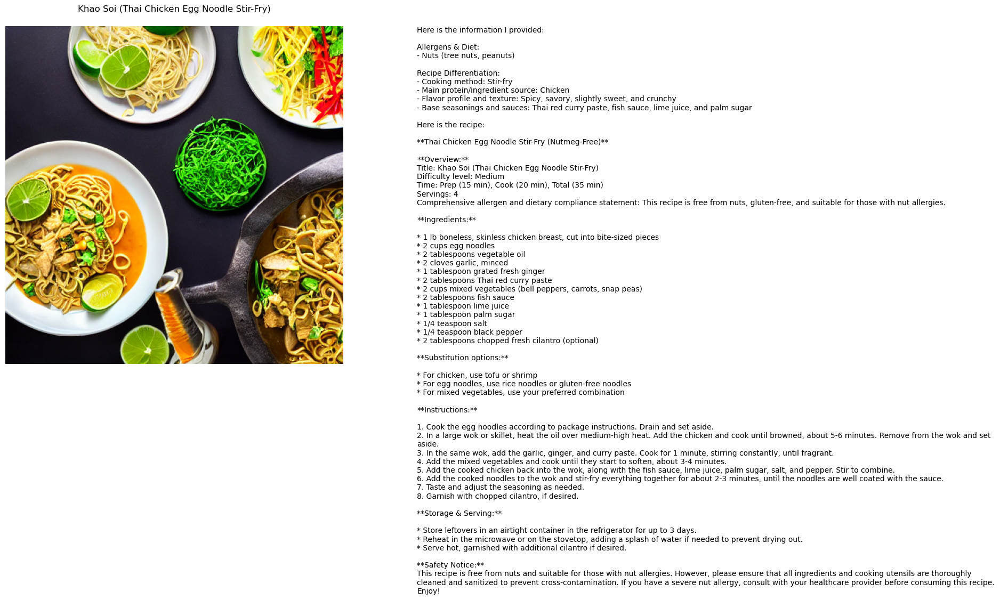

Complete recipe with image saved as complete_recipe.png

Recipe Generated Successfully:
Title: Khao Soi (Thai Chicken Egg Noodle Stir-Fry)

Recipe Content:
Here is the information I provided:

Allergens & Diet:
- Nuts (tree nuts, peanuts)

Recipe Differentiation:
- Cooking method: Stir-fry
- Main protein/ingredient source: Chicken
- Flavor profile and texture: Spicy, savory, slightly sweet, and crunchy
- Base seasonings and sauces: Thai red curry paste, fish sauce, lime juice, and palm sugar

Here is the recipe:

**Thai Chicken Egg Noodle Stir-Fry (Nutmeg-Free)**

**Overview:**
Title: Khao Soi (Thai Chicken Egg Noodle Stir-Fry)
Difficulty level: Medium
Time: Prep (15 min), Cook (20 min), Total (35 min)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, gluten-free, and suitable for those with nut allergies.

**Ingredients:**

* 1 lb boneless, skinless chicken breast, cut into bite-sized pieces
* 2 cups egg noodles
* 2 tablespoons vegetab

<Figure size 640x480 with 0 Axes>

In [49]:
# 3. Main execution
# Main execution
if __name__ == "__main__":
    try:
        # Initialize AWS JumpStart model
        image_model_id = "huggingface-txt2img-runwayml-stable-diffusion-v1-5"
        image_model = JumpStartModel(model_id=image_model_id, model_version="2.0.1")
        image_predictor = image_model.deploy()
        
        # Generate recipe with image
        query = "I am allergic to nuts. Can you give me a Thai egg noodle recipe free of nuts?"
        recipe_result = generate_single_recipe_with_image(llm, image_predictor, query)
        
        # Display and save the recipe with image
        display_and_save_recipe(recipe_result)
        
    except Exception as e:
        print(f"Major error in execution: {str(e)}")
        
    finally:
        # Clean up AWS resources
        try:
            image_predictor.delete_endpoint()
            print("\nSuccessfully cleaned up AWS endpoint")
        except Exception as e:
            print(f"Error cleaning up AWS endpoint: {str(e)}")

--------------!{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen ma

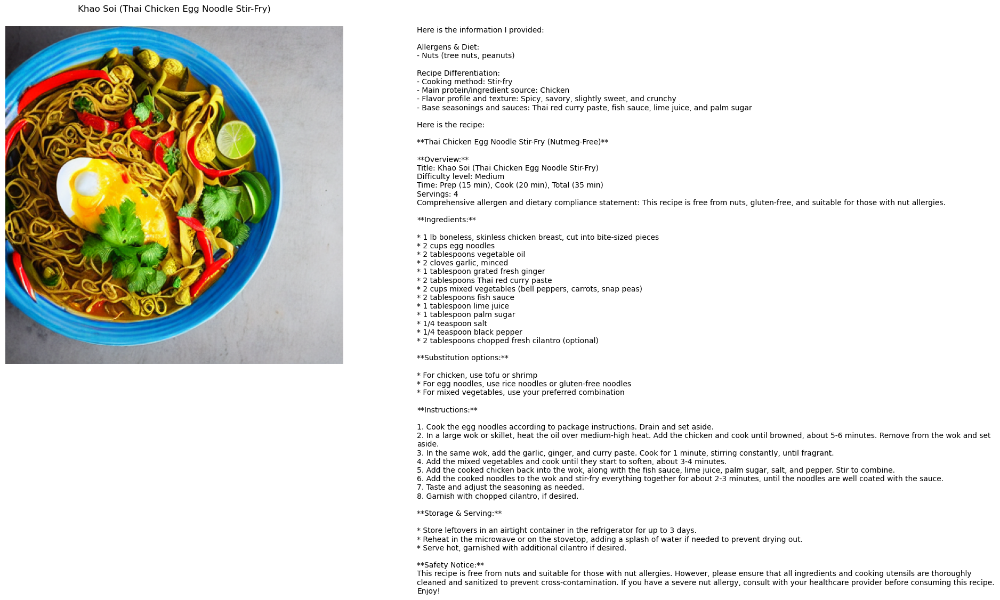

Complete recipe with image saved as complete_recipe.png

Recipe Generated Successfully:
Title: Khao Soi (Thai Chicken Egg Noodle Stir-Fry)

Recipe Content:
Here is the information I provided:

Allergens & Diet:
- Nuts (tree nuts, peanuts)

Recipe Differentiation:
- Cooking method: Stir-fry
- Main protein/ingredient source: Chicken
- Flavor profile and texture: Spicy, savory, slightly sweet, and crunchy
- Base seasonings and sauces: Thai red curry paste, fish sauce, lime juice, and palm sugar

Here is the recipe:

**Thai Chicken Egg Noodle Stir-Fry (Nutmeg-Free)**

**Overview:**
Title: Khao Soi (Thai Chicken Egg Noodle Stir-Fry)
Difficulty level: Medium
Time: Prep (15 min), Cook (20 min), Total (35 min)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, gluten-free, and suitable for those with nut allergies.

**Ingredients:**

* 1 lb boneless, skinless chicken breast, cut into bite-sized pieces
* 2 cups egg noodles
* 2 tablespoons vegetab

<Figure size 640x480 with 0 Axes>

In [50]:
# Initialize the model
image_model_id = "huggingface-txt2img-runwayml-stable-diffusion-v1-5"
image_model = JumpStartModel(model_id=image_model_id, model_version="2.0.1")
image_predictor = image_model.deploy()

try:
    # Generate and display recipe
    query = "I am allergic to nuts. Can you give me a Thai egg noodle recipe free of nuts?"
    recipe_result = generate_single_recipe_with_image(llm, image_predictor, query)
    display_and_save_recipe(recipe_result)
    
finally:
    # Clean up
    image_predictor.delete_endpoint()

### 3 Image recipes

In [89]:
from langchain.prompts import PromptTemplate
import numpy as np
from PIL import Image
import io
import matplotlib.pyplot as plt
import base64
from sagemaker.jumpstart.model import JumpStartModel

In [90]:
prompt_template = """You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate THREE (3) COMPLETELY DIFFERENT recipes based on the user's request.

SAFETY & REQUIREMENTS CHECK:
1. Allergens & Diet:
   - List all identified allergens and sensitivities
   - Religious/cultural dietary restrictions
   - Additional dietary preferences (e.g., low-sodium)
   - Cross-contamination concerns

2. Recipe Differentiation:
   Each recipe must have unique:
   - Cooking method (e.g., stir-fry, baked, grilled)
   - Main protein/ingredient source
   - Flavor profile and texture
   - Base seasonings and sauces

FOR EACH RECIPE PROVIDE:
1. Overview:
   - Title (with cultural origin if applicable)
   - Difficulty level (Easy/Medium/Hard)
   - Time (Prep/Cook/Total)
   - Servings
   - Comprehensive allergen and dietary compliance statement

2. Ingredients:
   - Full ingredient list with quantities
   - Clear allergen markings
   - 2-3 substitution options for main ingredients
   - Cross-contamination prevention notes

3. Instructions:
   - Clear, numbered steps
   - Critical technique notes
   - Safety measures for allergen handling
   - Common mistakes to avoid

4. Storage & Serving:
   - Plating suggestions
   - Storage guidelines
   - Safe reheating instructions

SAFETY NOTICE:
- Confirm allergen compliance
- Note cross-contamination risks
- Recommend healthcare provider consultation for severe allergies

Please provide three completely different recipes for: {query}
"""

PROMPT = PromptTemplate(
    template=prompt_template,
    input_variables=["query"]
)

In [91]:
def display_and_save_recipes(recipe_results):
    if not recipe_results:
        print("No recipes to display")
        return
        
    for recipe in recipe_results:
        # First, save just the clean image
        if recipe['image_data']:
            try:
                # Convert image data to format suitable for matplotlib
                if isinstance(recipe['image_data'], list):
                    img_array = np.array(recipe['image_data'], dtype=np.uint8)
                else:
                    img_array = np.array(Image.open(io.BytesIO(recipe['image_data'])))
                
                # Save clean image without any text
                Image.fromarray(img_array).save(f'recipe_image_{recipe["recipe_number"]}.png')
                print(f"Image saved as recipe_image_{recipe['recipe_number']}.png")
                
                # Display just the image
                plt.figure(figsize=(15, 10))
                plt.imshow(img_array)
                plt.axis('off')
                plt.title(recipe['title'], pad=20)
                plt.show()
                
            except Exception as e:
                print(f"Error handling image for recipe #{recipe['recipe_number']}: {str(e)}")
        
        # Then print the recipe text separately
        print(f"\nRecipe #{recipe['recipe_number']} Generated Successfully:")
        print(f"Title: {recipe['title']}")
        print("\nRecipe Content:")
        print(recipe['recipe_text'])
        print("\n" + "="*50 + "\n")
        
        # Save recipe text as separate file
        try:
            with open(f'recipe_{recipe["recipe_number"]}.txt', 'w', encoding='utf-8') as f:
                f.write(f"Title: {recipe['title']}\n\n")
                f.write(recipe['recipe_text'])
            print(f"Recipe text saved to recipe_{recipe['recipe_number']}.txt")
        except Exception as e:
            print(f"Error saving recipe text: {str(e)}")

def save_recipes_to_json(recipe_results):
    try:
        # Create a dictionary to store all recipes
        recipes_data = {
            'metadata': {
                'generated_date': datetime.now().isoformat(),
                'number_of_recipes': len(recipe_results)
            },
            'recipes': []
        }
        
        # Process each recipe
        for recipe in recipe_results:
            # Convert image data to base64 for JSON storage
            if recipe['image_data'] is not None:
                try:
                    if isinstance(recipe['image_data'], list):
                        # Convert numpy array to base64
                        image_array = np.array(recipe['image_data'], dtype=np.uint8)
                        image_bytes = image_array.tobytes()
                        image_data = base64.b64encode(image_bytes).decode('utf-8')
                    else:
                        # Already in bytes format
                        image_data = base64.b64encode(recipe['image_data']).decode('utf-8')
                except Exception as e:
                    print(f"Warning: Could not encode image data: {str(e)}")
                    image_data = None
            else:
                image_data = None
                
            recipe_data = {
                'recipe_number': recipe['recipe_number'],
                'title': recipe['title'],
                'recipe_text': recipe['recipe_text'],
                'image_data': image_data
            }
            
            recipes_data['recipes'].append(recipe_data)
        
        # Save to JSON file
        filename = f'thai_recipes_{datetime.now().strftime("%Y%m%d_%H%M%S")}.json'
        with open(filename, 'w', encoding='utf-8') as f:
            json.dump(recipes_data, f, indent=2, ensure_ascii=False)
            
        print(f"Recipes successfully saved to {filename}")
        
        # Also save a version without images for easy reading
        text_only_filename = f'thai_recipes_text_{datetime.now().strftime("%Y%m%d_%H%M%S")}.json'
        text_only_data = {
            'metadata': recipes_data['metadata'],
            'recipes': [{
                'recipe_number': r['recipe_number'],
                'title': r['title'],
                'recipe_text': r['recipe_text']
            } for r in recipes_data['recipes']]
        }
        
        with open(text_only_filename, 'w', encoding='utf-8') as f:
            json.dump(text_only_data, f, indent=2, ensure_ascii=False)
            
        print(f"Text-only version saved to {text_only_filename}")
        
        return filename, text_only_filename
        
    except Exception as e:
        print(f"Error saving recipes to JSON: {str(e)}")
        return None, None

------------!{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate THREE (3) COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allerge

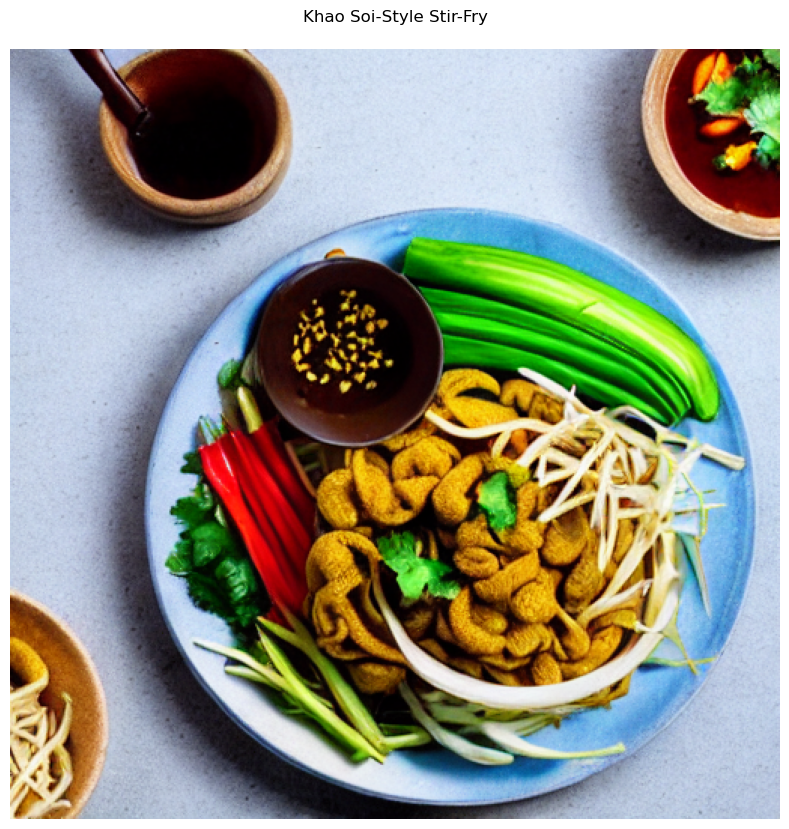


Recipe #1 Generated Successfully:
Title: Khao Soi-Style Stir-Fry

Recipe Content:
**Recipe 1: Stir-Fried Thai Egg Noodle with Chicken and Vegetables**
Overview:
Title: Khao Soi-Style Stir-Fry
Difficulty level: Medium
Time: 20 minutes (Prep: 10 minutes, Cook: 10 minutes, Total: 20 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound boneless, skinless chicken breast, cut into bite-sized pieces
* 2 tablespoons coconut oil
* 1 onion, thinly sliced
* 2 cloves garlic, minced
* 1 cup mixed vegetables (bell peppers, carrots, snap peas)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and pepper to taste
* Fresh cilantro leaves for garnish
Instructions:


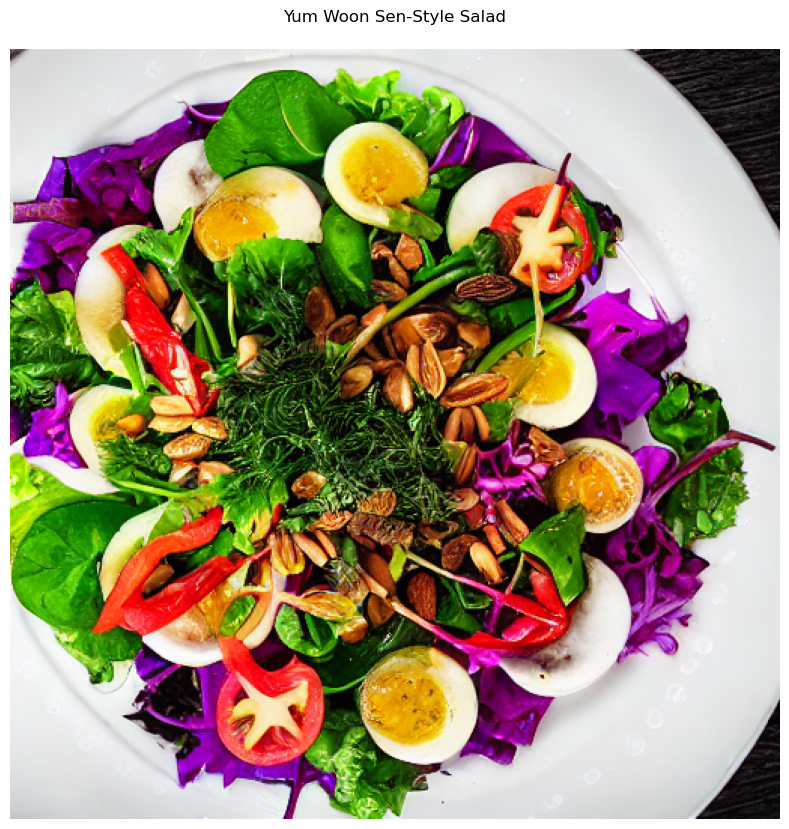


Recipe #2 Generated Successfully:
Title: Yum Woon Sen-Style Salad

Recipe Content:
**Recipe 2: Grilled Thai Egg Noodle Salad with Shrimp and Mango**
Overview:
Title: Yum Woon Sen-Style Salad
Difficulty level: Easy
Time: 25 minutes (Prep: 15 minutes, Cook: 10 minutes, Total: 25 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound large shrimp, peeled and deveined
* 2 tablespoons coconut oil
* 1 ripe mango, diced
* 1 cup mixed greens (such as arugula, spinach, and lettuce)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and pepper to taste
* Fresh cilantro leaves for garnish
Instructions:
1. Preheat a grill or grill pan to medium-high heat. Season

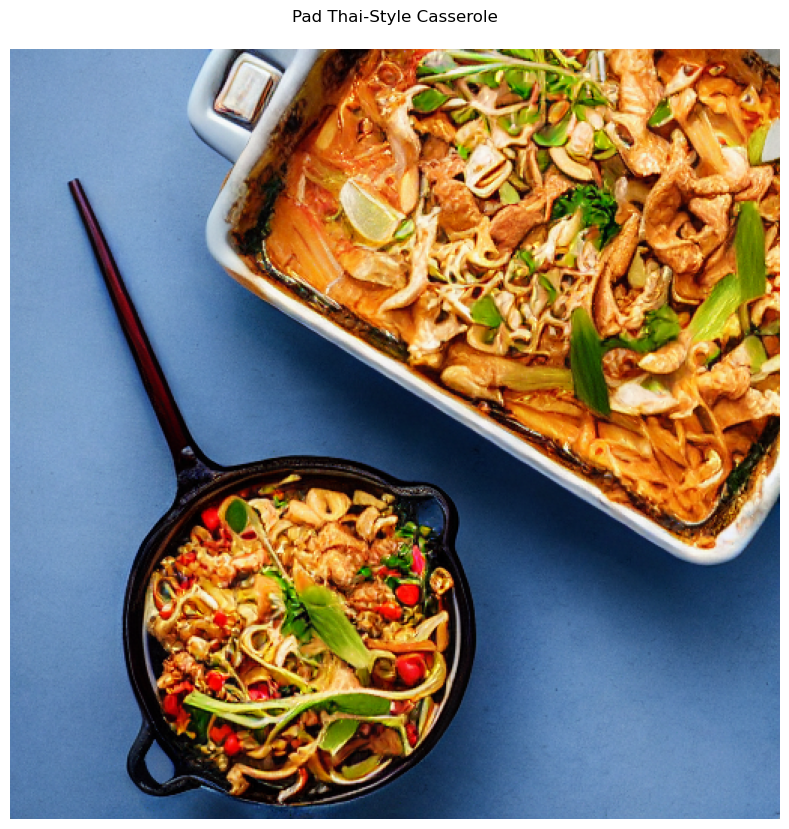


Recipe #3 Generated Successfully:
Title: Pad Thai-Style Casserole

Recipe Content:
**Recipe 3: Baked Thai Egg Noodle Casserole with Chicken and Vegetables**
Overview:
Title: Pad Thai-Style Casserole
Difficulty level: Medium
Time: 35 minutes (Prep: 15 minutes, Cook: 20 minutes, Total: 35 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound boneless, skinless chicken breast, cut into bite-sized pieces
* 2 tablespoons coconut oil
* 1 onion, thinly sliced
* 2 cloves garlic, minced
* 1 cup mixed vegetables (carrots, bell peppers, snap peas)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and pepper to taste
* 1 cup shredded coconut (make sure it's fr

In [92]:
# Main function
try:
    # Initialize AWS JumpStart model
    image_model_id = "huggingface-txt2img-runwayml-stable-diffusion-v1-5"
    image_model = JumpStartModel(model_id=image_model_id, model_version="2.0.1")
    image_predictor = image_model.deploy()
    
    # Generate recipes with images
    query = "I am allergic to nuts. Can you give me three different Thai egg noodle recipes free of nuts, each with a different cooking method and protein?"
    recipe_results = generate_multiple_recipes_with_images(llm, image_predictor, query)
    
    if recipe_results:
        print(f"Successfully generated {len(recipe_results)} recipes")
        # Display and save recipes
        display_and_save_recipes(recipe_results)
        
        # Save to JSON
        json_file, text_json_file = save_recipes_to_json(recipe_results)
        if json_file:
            print(f"Full recipes with images saved to: {json_file}")
            print(f"Text-only recipes saved to: {text_json_file}")
        else:
            print("Failed to save recipes to JSON")
    else:
        print("No recipes were generated")
    
except Exception as e:
    print(f"Major error in execution: {str(e)}")
    
finally:
    # Clean up AWS resources
    try:
        image_predictor.delete_endpoint()
        print("\nSuccessfully cleaned up AWS endpoint")
    except Exception as e:
        print(f"Error cleaning up AWS endpoint: {str(e)}")

In [78]:
# OLD CODE
def generate_multiple_recipes_with_images(llm, image_predictor, query):
    try:
        # Generate recipes
        response = llm.invoke(
            PROMPT.format(query=query)
        )
        
        # Split response into individual recipes
        recipes = []
        current_recipe = []
        recipe_started = False
        
        response_lines = response.split('\n')
        for line in response_lines:
            # Look for recipe markers including "Recipe 1:", "Recipe #1:", etc.
            if ('**Recipe' in line or 'Recipe' in line) and (':' in line or '#' in line):
                if current_recipe:
                    recipes.append('\n'.join(current_recipe))
                current_recipe = [line]
                recipe_started = True
            elif recipe_started and line.strip():
                current_recipe.append(line)
                
        if current_recipe:
            recipes.append('\n'.join(current_recipe))
        
        # Process each recipe
        recipe_results = []
        for i, recipe_text in enumerate(recipes, 1):
            try:
                # Extract title from the Overview section
                title = None
                recipe_lines = recipe_text.split('\n')
                
                # First try to find title in Overview section
                for j, line in enumerate(recipe_lines):
                    if "Title:" in line:
                        title = line.split("Title:")[1].strip()
                        break
                    # Backup: look for the recipe name at the start
                    elif ('**Recipe' in line or 'Recipe' in line) and (':' in line):
                        possible_title = line.split(':', 1)[1].strip()
                        if possible_title and not title:
                            title = possible_title
                
                if not title:
                    print(f"Could not extract title for recipe #{i}")
                    continue
                
                # Generate image
                print(f"Generating image for recipe #{i}: {title}")
                image_prompt = f"professional food photography of {title}, high resolution, appetizing, styled plating, restaurant quality"
                image_response = image_predictor.predict(
                    image_prompt, 
                    {"ContentType": "application/x-text", "Accept": "application/json"}
                )
                
                recipe_results.append({
                    'recipe_text': recipe_text,
                    'title': title,
                    'image_data': image_response.get('generated_image'),
                    'recipe_number': i
                })
                
            except Exception as e:
                print(f"Error processing recipe #{i}: {str(e)}")
                continue
        
        return recipe_results
        
    except Exception as e:
        print(f"Error generating recipes: {str(e)}")
        return None

------------!{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate THREE (3) COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allerge

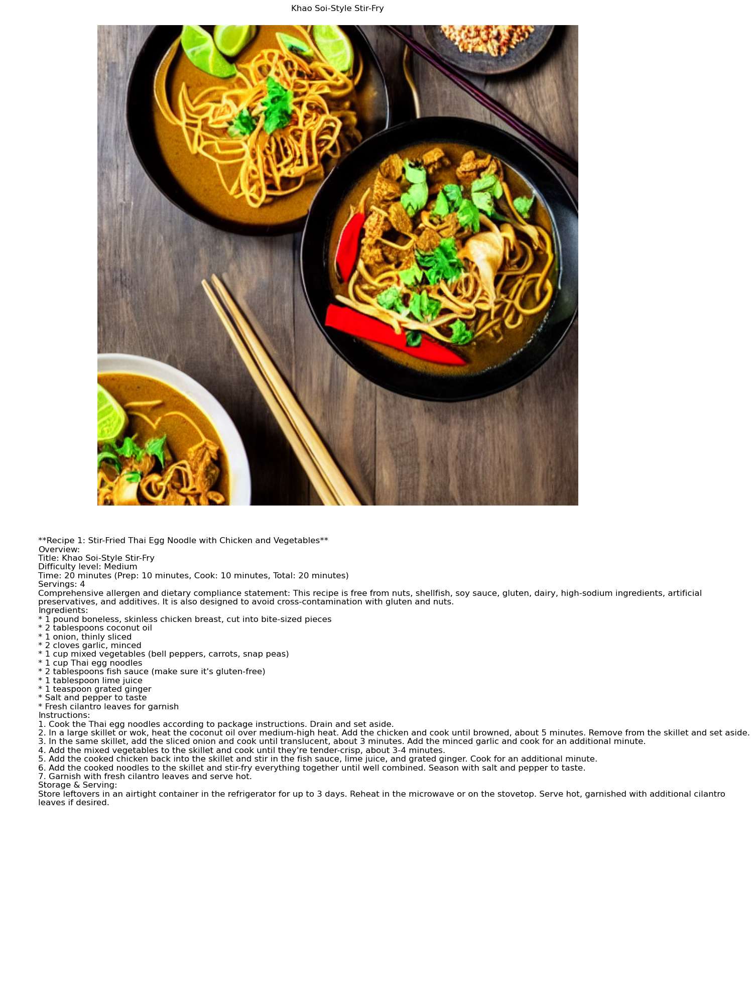

Complete recipe with image saved as complete_recipe_1.png

Recipe #1 Generated Successfully:
Title: Khao Soi-Style Stir-Fry

Recipe Content:
**Recipe 1: Stir-Fried Thai Egg Noodle with Chicken and Vegetables**
Overview:
Title: Khao Soi-Style Stir-Fry
Difficulty level: Medium
Time: 20 minutes (Prep: 10 minutes, Cook: 10 minutes, Total: 20 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound boneless, skinless chicken breast, cut into bite-sized pieces
* 2 tablespoons coconut oil
* 1 onion, thinly sliced
* 2 cloves garlic, minced
* 1 cup mixed vegetables (bell peppers, carrots, snap peas)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and pepper t

<Figure size 640x480 with 0 Axes>

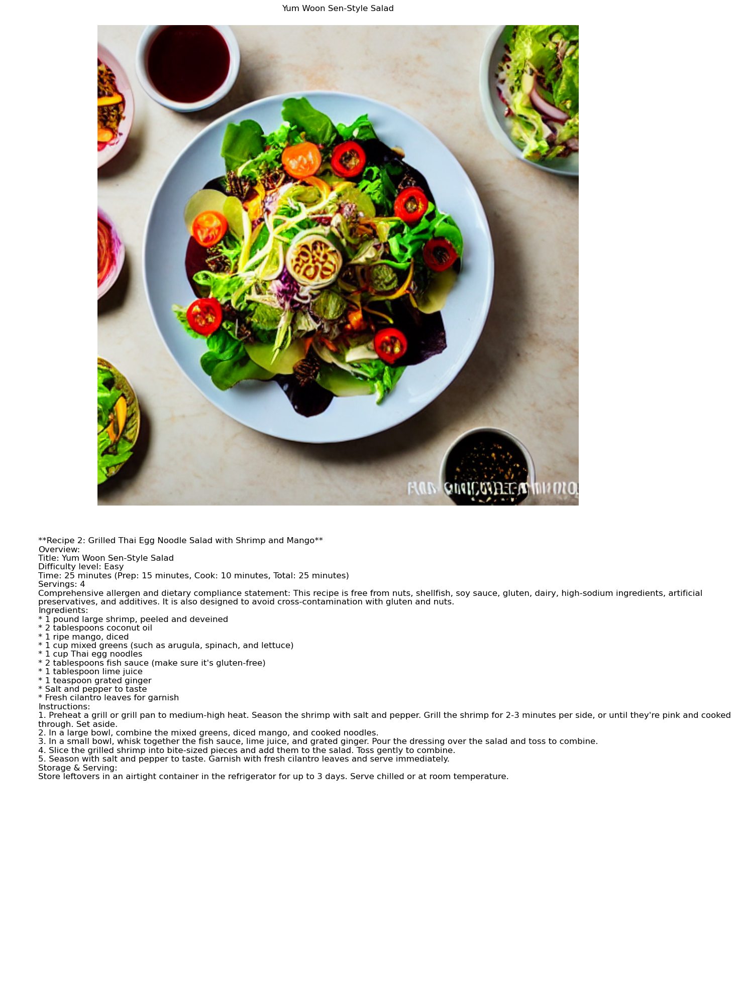

Complete recipe with image saved as complete_recipe_2.png

Recipe #2 Generated Successfully:
Title: Yum Woon Sen-Style Salad

Recipe Content:
**Recipe 2: Grilled Thai Egg Noodle Salad with Shrimp and Mango**
Overview:
Title: Yum Woon Sen-Style Salad
Difficulty level: Easy
Time: 25 minutes (Prep: 15 minutes, Cook: 10 minutes, Total: 25 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound large shrimp, peeled and deveined
* 2 tablespoons coconut oil
* 1 ripe mango, diced
* 1 cup mixed greens (such as arugula, spinach, and lettuce)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and pepper to taste
* Fresh cilantro leaves for garnish
Instructions:
1

<Figure size 640x480 with 0 Axes>

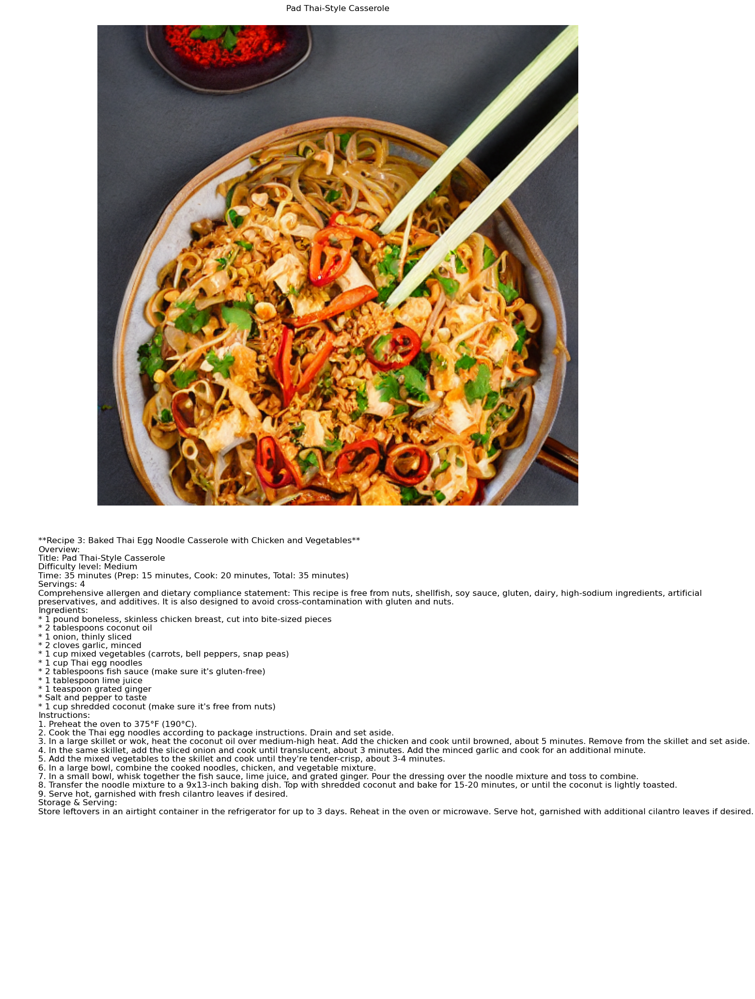

Complete recipe with image saved as complete_recipe_3.png

Recipe #3 Generated Successfully:
Title: Pad Thai-Style Casserole

Recipe Content:
**Recipe 3: Baked Thai Egg Noodle Casserole with Chicken and Vegetables**
Overview:
Title: Pad Thai-Style Casserole
Difficulty level: Medium
Time: 35 minutes (Prep: 15 minutes, Cook: 20 minutes, Total: 35 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound boneless, skinless chicken breast, cut into bite-sized pieces
* 2 tablespoons coconut oil
* 1 onion, thinly sliced
* 2 cloves garlic, minced
* 1 cup mixed vegetables (carrots, bell peppers, snap peas)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and p

<Figure size 640x480 with 0 Axes>

In [88]:
# Main execution
try:
    # Initialize AWS JumpStart model
    image_model_id = "huggingface-txt2img-runwayml-stable-diffusion-v1-5"
    image_model = JumpStartModel(model_id=image_model_id, model_version="2.0.1")
    image_predictor = image_model.deploy()
    
    # Generate recipes with images
    query = "I am allergic to nuts. Can you give me three different Thai egg noodle recipes free of nuts, each with a different cooking method and protein?"
    recipe_results = generate_multiple_recipes_with_images(llm, image_predictor, query)
    
    if recipe_results:
        print(f"Successfully generated {len(recipe_results)} recipes")
        display_and_save_recipes(recipe_results)
    else:
        print("No recipes were generated")
    
except Exception as e:
    print(f"Major error in execution: {str(e)}")
    
finally:
    # Clean up AWS resources
    try:
        image_predictor.delete_endpoint()
        print("\nSuccessfully cleaned up AWS endpoint")
    except Exception as e:
        print(f"Error cleaning up AWS endpoint: {str(e)}")

In [63]:
# Save recipes to json

In [ ]:
# run prompt

In [ ]:
# run def generate_multiple_recipes_with_images

In [79]:
def save_recipes_to_json(recipe_results):
    try:
        # Create a dictionary to store all recipes
        recipes_data = {
            'metadata': {
                'generated_date': datetime.now().isoformat(),
                'number_of_recipes': len(recipe_results)
            },
            'recipes': []
        }
        
        # Process each recipe
        for recipe in recipe_results:
            # Convert image data to base64 for JSON storage
            if recipe['image_data'] is not None:
                try:
                    if isinstance(recipe['image_data'], list):
                        # Convert numpy array to base64
                        image_array = np.array(recipe['image_data'], dtype=np.uint8)
                        image_bytes = image_array.tobytes()
                        image_data = base64.b64encode(image_bytes).decode('utf-8')
                    else:
                        # Already in bytes format
                        image_data = base64.b64encode(recipe['image_data']).decode('utf-8')
                except Exception as e:
                    print(f"Warning: Could not encode image data: {str(e)}")
                    image_data = None
            else:
                image_data = None
                
            recipe_data = {
                'recipe_number': recipe['recipe_number'],
                'title': recipe['title'],
                'recipe_text': recipe['recipe_text'],
                'image_data': image_data
            }
            
            recipes_data['recipes'].append(recipe_data)
        
        # Save to JSON file
        filename = f'thai_recipes_{datetime.now().strftime("%Y%m%d_%H%M%S")}.json'
        with open(filename, 'w', encoding='utf-8') as f:
            json.dump(recipes_data, f, indent=2, ensure_ascii=False)
            
        print(f"Recipes successfully saved to {filename}")
        
        # Also save a version without images for easy reading
        text_only_filename = f'thai_recipes_text_{datetime.now().strftime("%Y%m%d_%H%M%S")}.json'
        text_only_data = {
            'metadata': recipes_data['metadata'],
            'recipes': [{
                'recipe_number': r['recipe_number'],
                'title': r['title'],
                'recipe_text': r['recipe_text']
            } for r in recipes_data['recipes']]
        }
        
        with open(text_only_filename, 'w', encoding='utf-8') as f:
            json.dump(text_only_data, f, indent=2, ensure_ascii=False)
            
        print(f"Text-only version saved to {text_only_filename}")
        
        return filename, text_only_filename
        
    except Exception as e:
        print(f"Error saving recipes to JSON: {str(e)}")
        return None, None

--------------!{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate THREE (3) COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear aller

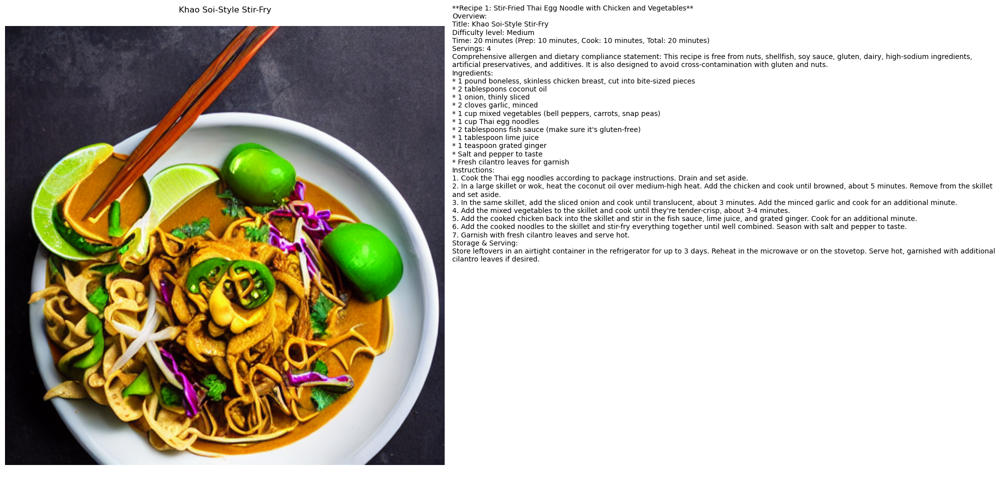

Complete recipe with image saved as complete_recipe_1.png

Recipe #1 Generated Successfully:
Title: Khao Soi-Style Stir-Fry

Recipe Content:
**Recipe 1: Stir-Fried Thai Egg Noodle with Chicken and Vegetables**
Overview:
Title: Khao Soi-Style Stir-Fry
Difficulty level: Medium
Time: 20 minutes (Prep: 10 minutes, Cook: 10 minutes, Total: 20 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound boneless, skinless chicken breast, cut into bite-sized pieces
* 2 tablespoons coconut oil
* 1 onion, thinly sliced
* 2 cloves garlic, minced
* 1 cup mixed vegetables (bell peppers, carrots, snap peas)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and pepper t

<Figure size 640x480 with 0 Axes>

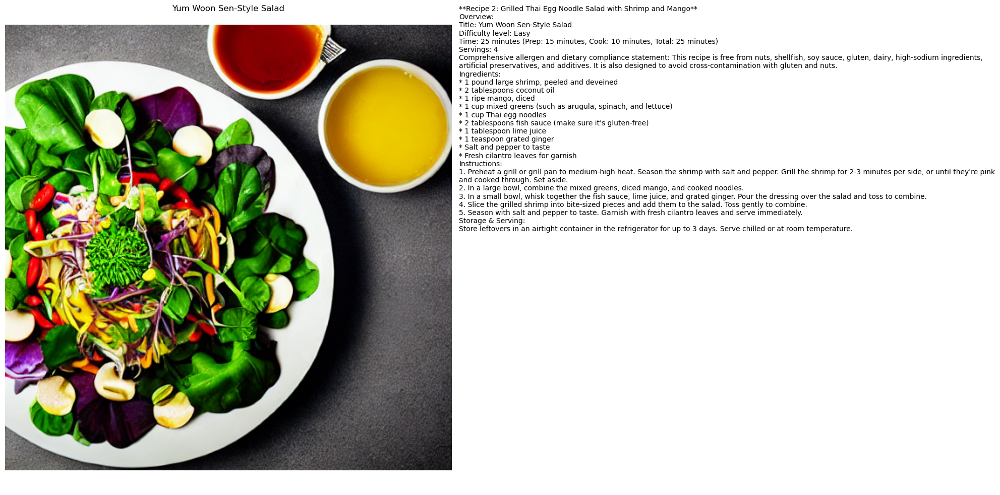

Complete recipe with image saved as complete_recipe_2.png

Recipe #2 Generated Successfully:
Title: Yum Woon Sen-Style Salad

Recipe Content:
**Recipe 2: Grilled Thai Egg Noodle Salad with Shrimp and Mango**
Overview:
Title: Yum Woon Sen-Style Salad
Difficulty level: Easy
Time: 25 minutes (Prep: 15 minutes, Cook: 10 minutes, Total: 25 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound large shrimp, peeled and deveined
* 2 tablespoons coconut oil
* 1 ripe mango, diced
* 1 cup mixed greens (such as arugula, spinach, and lettuce)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and pepper to taste
* Fresh cilantro leaves for garnish
Instructions:
1

<Figure size 640x480 with 0 Axes>

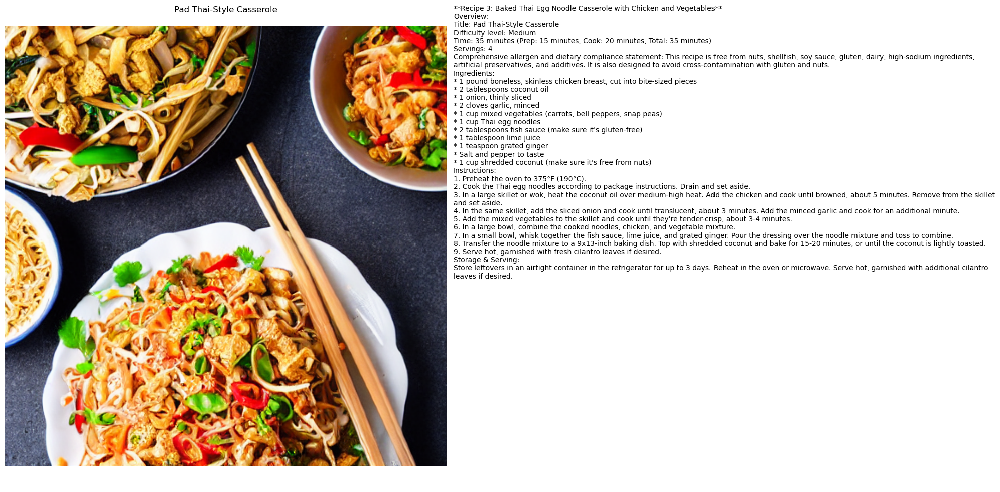

Complete recipe with image saved as complete_recipe_3.png

Recipe #3 Generated Successfully:
Title: Pad Thai-Style Casserole

Recipe Content:
**Recipe 3: Baked Thai Egg Noodle Casserole with Chicken and Vegetables**
Overview:
Title: Pad Thai-Style Casserole
Difficulty level: Medium
Time: 35 minutes (Prep: 15 minutes, Cook: 20 minutes, Total: 35 minutes)
Servings: 4
Comprehensive allergen and dietary compliance statement: This recipe is free from nuts, shellfish, soy sauce, gluten, dairy, high-sodium ingredients, artificial preservatives, and additives. It is also designed to avoid cross-contamination with gluten and nuts.
Ingredients:
* 1 pound boneless, skinless chicken breast, cut into bite-sized pieces
* 2 tablespoons coconut oil
* 1 onion, thinly sliced
* 2 cloves garlic, minced
* 1 cup mixed vegetables (carrots, bell peppers, snap peas)
* 1 cup Thai egg noodles
* 2 tablespoons fish sauce (make sure it's gluten-free)
* 1 tablespoon lime juice
* 1 teaspoon grated ginger
* Salt and p

<Figure size 640x480 with 0 Axes>

In [80]:
try:
    # Initialize AWS JumpStart model
    image_model_id = "huggingface-txt2img-runwayml-stable-diffusion-v1-5"
    image_model = JumpStartModel(model_id=image_model_id, model_version="2.0.1")
    image_predictor = image_model.deploy()
    
    # Generate recipes with images
    query = "I am allergic to nuts. Can you give me three different Thai egg noodle recipes free of nuts, each with a different cooking method and protein?"
    recipe_results = generate_multiple_recipes_with_images(llm, image_predictor, query)
    
    if recipe_results:
        print(f"Successfully generated {len(recipe_results)} recipes")
        # First display recipes
        display_and_save_recipes(recipe_results)
        
        # Then save to JSON
        json_file, text_json_file = save_recipes_to_json(recipe_results)
        if json_file:
            print(f"Full recipes with images saved to: {json_file}")
            print(f"Text-only recipes saved to: {text_json_file}")
        else:
            print("Failed to save recipes to JSON")
    else:
        print("No recipes were generated")
    
except Exception as e:
    print(f"Major error in execution: {str(e)}")
    
finally:
    # Clean up AWS resources
    try:
        image_predictor.delete_endpoint()
        print("\nSuccessfully cleaned up AWS endpoint")
    except Exception as e:
        print(f"Error cleaning up AWS endpoint: {str(e)}")

#### Recipes with image only

#### 3 Recipes together for same scenario - see other Notebook (Llama3 8b_bge_enlarge_2024_2024_102_202411036)

In [35]:
# Function to get multiple recipes
def get_multiple_recipes(llm, query, num_recipes):
    recipes = []
    try:
        for i in range(num_recipes):
            modified_query = f"""Give me recipe #{i+1} for: {query} 
            Important: This recipe must be COMPLETELY DIFFERENT in style, preparation method, and ingredients from any previous recipes."""
            
            response = llm.invoke(
                PROMPT.format(
                    query=modified_query,
                    num_recipes="1"
                )
            )
            
            formatted_response = f"\n=== Recipe {i+1} ===\n{response}"
            recipes.append(formatted_response)
        
        return "\n\n".join(recipes)
    except Exception as e:
        print(f"Detailed error: {str(e)}")
        return None

# Allergy = Nut & Treenut / cousine = Thai
try:
    query = "I am allergic to nuts. Can you give me a Thai egg noodle recipe free of nuts?"
    multi_recipes = get_multiple_recipes(llm, query, 3)
    print(multi_recipes)
except Exception as e:
    print(f"Error: {e}")

{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen markings\n   - 2-

In [36]:
# Function to get multiple recipes
def get_multiple_recipes(llm, query, num_recipes):
    recipes = []
    try:
        for i in range(num_recipes):
            modified_query = f"""Give me recipe #{i+1} for: {query} 
            Important: This recipe must be COMPLETELY DIFFERENT in style, preparation method, and ingredients from any previous recipes."""
            
            response = llm.invoke(
                PROMPT.format(
                    query=modified_query,
                    num_recipes="1"
                )
            )
            
            formatted_response = f"\n=== Recipe {i+1} ===\n{response}"
            recipes.append(formatted_response)
        
        return "\n\n".join(recipes)
    except Exception as e:
        print(f"Detailed error: {str(e)}")
        return None

# Allergy = Gluten (Wheat) / cousine = Italian
try:
    query = "I have celiac disease. Please suggest an Italian polenta-based recipe that's naturally gluten-free."
    multi_recipes = get_multiple_recipes(llm, query, 3)
    print(multi_recipes)
except Exception as e:
    print(f"Error: {e}")

{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen markings\n   - 2-

In [42]:
# Function to get multiple recipes
def get_multiple_recipes(llm, query, num_recipes):
    recipes = []
    try:
        for i in range(num_recipes):
            modified_query = f"""Give me recipe #{i+1} for: {query} 
            Important: This recipe must be COMPLETELY DIFFERENT in style, preparation method, and ingredients from any previous recipes."""
            
            response = llm.invoke(
                PROMPT.format(
                    query=modified_query,
                    num_recipes="1"
                )
            )
            
            formatted_response = f"\n=== Recipe {i+1} ===\n{response}"
            recipes.append(formatted_response)
        
        return "\n\n".join(recipes)
    except Exception as e:
        print(f"Detailed error: {str(e)}")
        return 

# Allergy = Milk & Egg / cousine = Dessert
try:
    query = "Looking for an ice cream alternative - I'm allergic to milk and eggs. Can you suggest a frozen dessert recipe?"
    multi_recipes = get_multiple_recipes(llm, query, 3)
    print(multi_recipes)
except Exception as e:
    print(f"Error: {e}")

{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen markings\n   - 2-

In [43]:
# Function to get multiple recipes
def get_multiple_recipes(llm, query, num_recipes):
    recipes = []
    try:
        for i in range(num_recipes):
            modified_query = f"""Give me recipe #{i+1} for: {query} 
            Important: This recipe must be COMPLETELY DIFFERENT in style, preparation method, and ingredients from any previous recipes."""
            
            response = llm.invoke(
                PROMPT.format(
                    query=modified_query,
                    num_recipes="1"
                )
            )
            
            formatted_response = f"\n=== Recipe {i+1} ===\n{response}"
            recipes.append(formatted_response)
        
        return "\n\n".join(recipes)
    except Exception as e:
        print(f"Detailed error: {str(e)}")
        return None

# Allergy = Soy / cousine = Vegan
try:
    query = "I am allergic to soy and eat vegan. Can you share a recipe for a protein-rich main dish using legumes instead of soy products?"
    multi_recipes = get_multiple_recipes(llm, query, 3)
    print(multi_recipes)
except Exception as e:
    print(f"Error: {e}")

{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen markings\n   - 2-

In [44]:
# Function to get multiple recipes
def get_multiple_recipes(llm, query, num_recipes):
    recipes = []
    try:
        for i in range(num_recipes):
            modified_query = f"""Give me recipe #{i+1} for: {query} 
            Important: This recipe must be COMPLETELY DIFFERENT in style, preparation method, and ingredients from any previous recipes."""
            
            response = llm.invoke(
                PROMPT.format(
                    query=modified_query,
                    num_recipes="1"
                )
            )
            
            formatted_response = f"\n=== Recipe {i+1} ===\n{response}"
            recipes.append(formatted_response)
        
        return "\n\n".join(recipes)
    except Exception as e:
        print(f"Detailed error: {str(e)}")
        return 

# Allergy = Fish & Crustacean / cousine = Japanese
try:
    query = "I have seafood allergies (fish and shellfish). Can you provide a recipe for vegetable tempura with a dipping sauce that doesn't contain dashi or fish sauce?"
    multi_recipes = get_multiple_recipes(llm, query, 3)
    print(multi_recipes)
except Exception as e:
    print(f"Error: {e}")

{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen markings\n   - 2-

In [45]:
import pandas as pd

def generate_recipes():
    generated_recipes = []
    recipes_dict_list = []  # For CSV structure
    
    # List of scenarios with their queries
    scenarios = [
        "I am allergic to nuts and tree nuts. Can you give me a Thai curry recipe free of nuts?",
        "I am allergic to wheat (gluten). Can you give me an Italian chicken recipe that's gluten-free?",
        "I am allergic to milk and eggs. Can you give me a dessert recipe free from these allergens?",
        "I am allergic to soy. Can you give me a vegan taco recipe without soy?",
        "I am allergic to fish and shellfish. Can you give me a Japanese dumpling recipe free from seafood?"
    ]
    
    for scenario_idx, query in enumerate(scenarios, 1):
        # Generate 3 recipes for each scenario
        for recipe_num in range(1, 4):
            try:
                response = llm.invoke(
                    PROMPT.format(
                        query=f"Give me recipe #{recipe_num} for: {query} Important: This recipe must be COMPLETELY DIFFERENT in style, preparation method, and ingredients from any previous recipes.",
                        num_recipes="1"
                    )
                )
                
                # Store complete response for text file
                generated_recipes.append(f"\n=== Scenario {scenario_idx}, Recipe {recipe_num} ===\n")
                generated_recipes.append(f"Query: {query}\n")
                generated_recipes.append(response)
                generated_recipes.append("\n" + "="*50 + "\n")
                
                # Parse for CSV structure
                recipe_dict = {
                    'scenario': f"Scenario {scenario_idx}",
                    'query': query,
                    'recipe_number': f"Recipe {recipe_num}",
                    'full_recipe': response
                }
                recipes_dict_list.append(recipe_dict)
                
            except Exception as e:
                print(f"Error in Scenario {scenario_idx}, Recipe {recipe_num}: {e}")
                continue
    
    # Save as text file
    with open('generated_recipes.txt', 'w') as f:
        f.write('\n'.join(generated_recipes))
    
    # Save as CSV
    #df = pd.DataFrame(recipes_dict_list)
    #df.to_csv('generated_recipes.csv', index=False)
    
    return generated_recipes

# Run generation silently
try:
    _ = generate_recipes()
except Exception as e:
    print(f"Error in recipe generation: {e}")

{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen markings\n   - 2-

In [46]:
import json

def generate_recipes():
    recipes_database = {
        'scenarios': []
    }
    
    scenarios = [
        "I am allergic to nuts and tree nuts. Can you give me a Thai curry recipe free of nuts?",
        "I am allergic to wheat (gluten). Can you give me an Italian chicken recipe that's gluten-free?",
        "I am allergic to milk and eggs. Can you give me a dessert recipe free from these allergens?",
        "I am allergic to soy. Can you give me a vegan taco recipe without soy?",
        "I am allergic to fish and shellfish. Can you give me a Japanese dumpling recipe free from seafood?"
    ]
    
    for scenario_idx, query in enumerate(scenarios, 1):
        scenario_data = {
            'scenario_id': scenario_idx,
            'query': query,
            'recipes': []
        }
        
        for recipe_num in range(1, 4):
            try:
                response = llm.invoke(
                    PROMPT.format(
                        query=f"Give me recipe #{recipe_num} for: {query} Important: This recipe must be COMPLETELY DIFFERENT in style, preparation method, and ingredients from any previous recipes.",
                        num_recipes="1"
                    )
                )
                
                # Parse recipe into structured data
                recipe_data = {
                    'recipe_id': recipe_num,
                    'title': '',
                    'allergen_info': '',
                    'cuisine_authenticity': '',
                    'ingredients': '',
                    'instructions': '',
                    'serving_storage': '',
                    'safety_check': ''
                }
                
                # Parse the response into sections
                sections = response.split('**')
                for section in sections:
                    if 'Recipe' in section and 'title' not in section.lower():
                        recipe_data['title'] = section.strip()
                    elif 'Allergen Information' in section:
                        recipe_data['allergen_info'] = section.strip()
                    elif 'Cuisine Authenticity' in section:
                        recipe_data['cuisine_authenticity'] = section.strip()
                    elif 'Ingredients' in section:
                        recipe_data['ingredients'] = section.strip()
                    elif 'Instructions' in section:
                        recipe_data['instructions'] = section.strip()
                    elif 'Serving & Storage' in section:
                        recipe_data['serving_storage'] = section.strip()
                    elif 'Final Safety Check' in section:
                        recipe_data['safety_check'] = section.strip()
                
                scenario_data['recipes'].append(recipe_data)
                
            except Exception as e:
                continue
        
        recipes_database['scenarios'].append(scenario_data)
    
    # Save to JSON file
    with open('recipes_database.json', 'w', encoding='utf-8') as f:
        json.dump(recipes_database, f, indent=2, ensure_ascii=False)
    
    return recipes_database

# Run generation
try:
    recipes_database = generate_recipes()
except Exception as e:
    pass

{"inputs": "You are a professional chef and certified nutritionist specializing in food allergies and dietary restrictions. Generate 1 COMPLETELY DIFFERENT recipes based on the user's request.\n\nSAFETY & REQUIREMENTS CHECK:\n1. Allergens & Diet:\n   - List all identified allergens and sensitivities\n   - Religious/cultural dietary restrictions\n   - Additional dietary preferences (e.g., low-sodium)\n   - Cross-contamination concerns\n\n2. Recipe Differentiation:\n   Each recipe must have unique:\n   - Cooking method (e.g., stir-fry, baked, grilled)\n   - Main protein/ingredient source\n   - Flavor profile and texture\n   - Base seasonings and sauces\n\nFOR EACH RECIPE PROVIDE:\n\n1. Overview:\n   - Title (with cultural origin if applicable)\n   - Difficulty level (Easy/Medium/Hard)\n   - Time (Prep/Cook/Total)\n   - Servings\n   - Comprehensive allergen and dietary compliance statement\n\n2. Ingredients:\n   - Full ingredient list with quantities\n   - Clear allergen markings\n   - 2-